In [176]:
import pandas as pd
from urllib.request import urlopen
import json
import plotly.express as px
from datetime import datetime, timedelta

In [177]:
#get data from different sourses and cleansing
df = pd.read_csv('https://raw.githubusercontent.com/ccodwg/Covid19Canada/master/timeseries_prov/active_timeseries_prov.csv')
df['date_active'].astype('str')
df=df.replace({'province': {'BC': 'British Columbia', 'NL': 'Newfoundland and Labrador', 'NWT':'Northwest Territories', 'PEI':'Prince Edward Island'}})
df['code']=df['province']
df = df.replace({'code': {'Newfoundland and Labrador':10, 'Prince Edward Island':11, 'Nova Scotia':12, 
                          'New Brunswick':13, 'Quebec':24, 'Ontario':35, 'Manitoba':53, 'Saskatchewan':47, 
                          'Alberta':48, 'British Columbia':59, 'Yukon':60, 'Northwest Territories':61, 'Nunavut':62}})

with open("georef-canada-province.geojson", "r") as geo:
    provinces = json.load(geo)

,province,date_active,cumulative_cases,cumulative_recovered,cumulative_deaths,active_cases,active_cases_change,code
9025,Yukon,26-10-2021,892,840,10,42,-5,60
9026,Yukon,27-10-2021,902,845,10,47,5,60
9027,Yukon,28-10-2021,913,851,10,52,5,60
9028,Yukon,29-10-2021,921,856,10,55,3,60
9029,Yukon,30-10-2021,921,856,10,55,0,60


In [185]:
yesterday = datetime.now() - timedelta(1)                                                                                                                                                                                   
yes = datetime.strftime(yesterday, '%d-%m-%Y')

In [186]:
def get_data(date):   
    data_by_date = df.loc[df['date_active']==date]
    return data_by_date
df = get_data(yes)


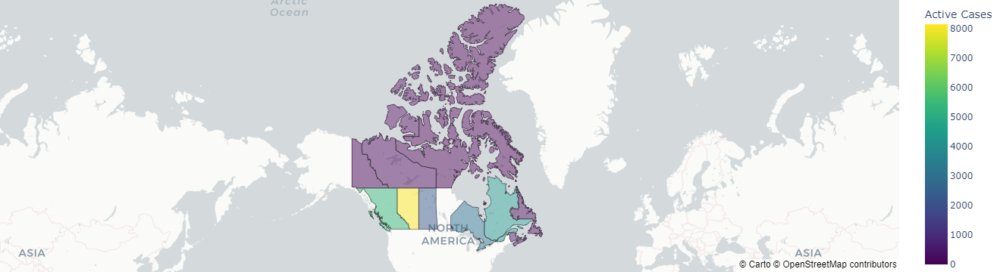

In [187]:
map_ca = px.choropleth_mapbox(df, 
                           geojson=provinces, 
                           featureidkey= 'properties.prov_code',
                           locations='code', 
                           color='active_cases',
                           color_continuous_scale="Viridis",
                           range_color=(0, df['active_cases'].max()),
                           mapbox_style="carto-positron",
                           zoom=1, center = {"lat": 70.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'active_cases':'Active Cases'},
                          )
map_ca.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
map_ca.show()

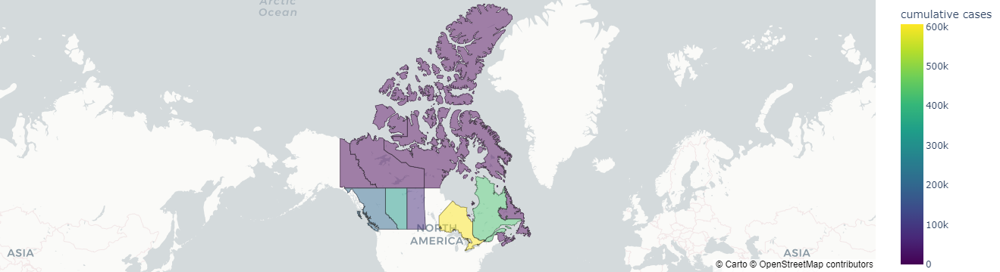

In [188]:
map_cc = px.choropleth_mapbox(df, 
                           geojson=provinces, 
                           featureidkey= 'properties.prov_code',
                           locations='code', 
                           color='cumulative_cases',
                           color_continuous_scale="Viridis",
                           range_color=(0, df['cumulative_cases'].max()),
                           mapbox_style="carto-positron",
                           zoom=1, center = {"lat": 70.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'cumulative_cases':'cumulative cases'},
                          )
map_cc.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
map_cc.show()

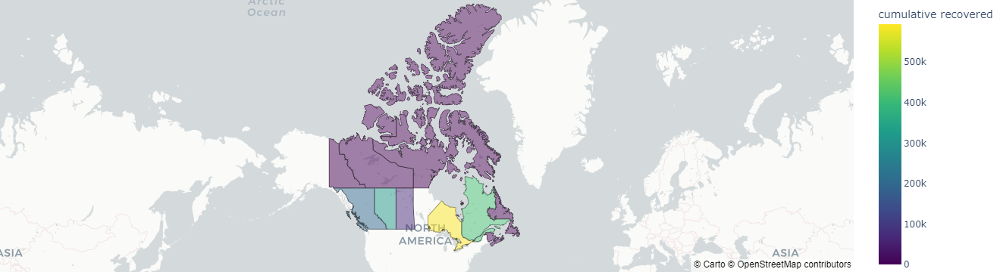

In [189]:
map_cr = px.choropleth_mapbox(df, 
                           geojson=provinces, 
                           featureidkey= 'properties.prov_code',
                           locations='code', 
                           color='cumulative_recovered',
                           color_continuous_scale="Viridis",
                           range_color=(0, df['cumulative_recovered'].max()),
                           mapbox_style="carto-positron",
                           zoom=1, center = {"lat": 70.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'cumulative_recovered':'cumulative recovered'},
                          )
map_cr.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
map_cr.show()

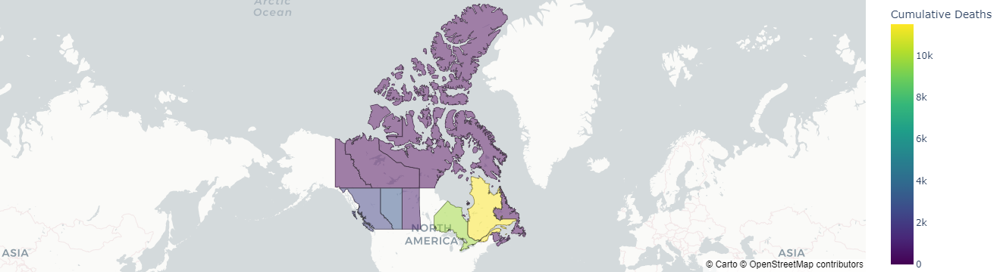

In [190]:
map_cd = px.choropleth_mapbox(df, 
                           geojson=provinces, 
                           featureidkey= 'properties.prov_code',
                           locations='code', 
                           color='cumulative_deaths',
                           color_continuous_scale="Viridis",
                           range_color=(0, df['cumulative_deaths'].max()),
                           mapbox_style="carto-positron",
                           zoom=1, center = {"lat": 70.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'cumulative_deaths':'Cumulative Deaths'},
                          )
map_cd.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
map_cd.show()